In [79]:
%matplotlib inline
import matplotlib.pyplot as plt # 2D plotting library (www.matplotlib.org)
import numpy as np # library for efficient numerical computing with arrays (www.numpy.org)
import pygimli as pg # *G*eophysical *I*nversion and *M*odeling *Li*brary (www.pygimli.org)
import pygimli.meshtools as mt
#import pybert as pb

ModuleNotFoundError: No module named 'pybert'

# Calculations and values

## world dimensions: 
x-direction [m]: 0-20  
y-direction [m]: 0-10  

## hydraulic potential:
solve Darcy with Finite Elements for hydraulic head distribution [m]:  
$$\nabla \cdot (K \nabla h) = 0$$  
h1 [m] = 5  
h2 [m] = 0.2  
hydraulic conductivity K [m/s]:  
world: $10^{-4}$  
circle: $10^{-7}$  
polygon: $10^{-8}$  
boundary conditions: Dirichlet (left: h1, right: h2)  
velocity v [m/s]: $\textbf{v} = \frac{-K \nabla h} {\phi}$  
$\textbf{v}_{abs} = \sqrt{\textbf{v}_x^2 + \textbf{v}_y^2}$  
porosity $\phi$ = 0.3  
## streaming potential:
solve streaming potential equation with Finite Elements for streaming potential $\varphi$ [V]:  
$$\nabla \cdot (\sigma \nabla \varphi) = \nabla \cdot (L \textbf{v})$$  
L = 10  
$\varphi1$ [V] = 0  
$\varphi2$ [V] = 0  
boundary conditions: Dirichlet (left: $\varphi1$, right: $\varphi2$)    
electrical conductivity $\sigma$ [S/m]:  
world: $9 \cdot 10^{-1}$  
circle: $3 \cdot 10^{-4}$  
polygon: $10^{-4}$
## tracer transport:
solve transport equation with Finite Volume for concentration c [g/l]:  
$$\frac{\partial c}{\partial t} = \underbrace{\nabla\cdot(D \nabla c)}_{\text{Diffusion / Dispersion}} - \underbrace{\mathbf{v}\nabla c}_{\text{Advection}} + S$$
3 tracer injection positions S[x,y]:  
position1 = [5,2.5]  
position2 = [2.5,7]  
position3 = [8,6.5]  
injection load [g/l]: 0.001  
dispersion rate D [m/s]: D = $\alpha \cdot \textbf{v}_{abs}$  
$\alpha = 10^{-3}$  
##### timestepping:
steps: 100  
timeperiod [days] = 5  
intervall $\Delta t$ = timeperiod[sec]/(steps-1) = 4363.6 sec  
injections stopped after: steps/2  
#### CFL criterion:  
$\Delta x$ = 0.15 m  
$v_{max}$ = 0.000166 m/s  
c = $\frac{v_{max} \Delta t} {\Delta x}$ = 4.78  
## electrical conductivity:
$\sigma_0$ [S/m] = 0.01  
$\sigma_W =$ 0.1$ c + \sigma_0$  
$\sigma_W$  = 0.01-1000 S/m  
## electrical resitivity:
Archie's equation for $\rho_b$ [$\Omega m$]:  
$$\rho_b = a \cdot (1/\sigma_W)\cdot\phi^{-m}\cdot S^{-n}$$
$\rho_b = 10^{-3}-25  \Omega m$  
a=1  
m=2  
S=1  
n=2  

# Create world with geometry

(<AxesSubplot:>, None)

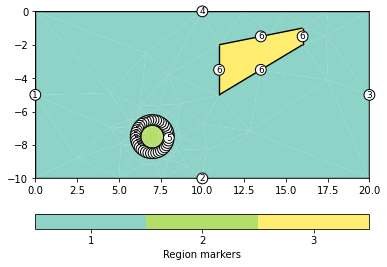

In [3]:
#lengths:
l1 = 0 #m
l2 = 20 #m
#heights:
ht1 = -10 #m
ht2 = 0 #m

world = mt.createWorld(start=[l1, ht1], end=[l2, ht2], worldMarker = False)
circle = mt.createCircle(pos=[7,-7.5], radius=1, segments=40, marker=2, boundaryMarker=5, start=0, end=6.283185307179586)
#block = mt.createRectangle(start=[15, 0.5], end=[17.4, 2.5], area=0.5)
poly = mt.createPolygon([[11, -5], [11, -2], [16, -1], [16, -2]], isClosed=True, marker=3, boundaryMarker = 6)
geometry = mt.mergePLC([world, circle, poly])
mesh1 = mt.createMesh(geometry, quality=34, markers = True, area=0.1)
mesh2 = mt.createMesh(geometry, quality=5, markers = True, area=10)
pg.show(geometry, markers=True)

## Quality test

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x1eaa89fb188>)

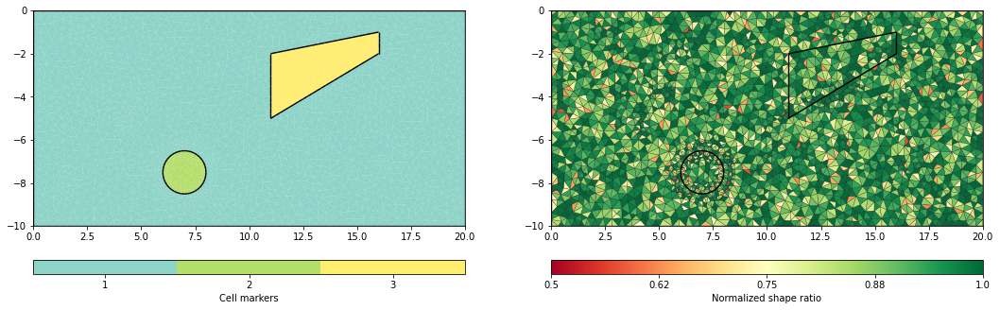

In [5]:
fig,ax = plt.subplots(1,2,figsize=(18, 9))
pg.show(mesh1, ax=ax[0], markers=True, hold=True)
qual1 = mt.quality(mesh1, "nsr")
pg.show(mesh1, qual1, ax=ax[1], cMap="RdYlGn", showMesh=True, hold=True, cMin=0.5, cMax=1.0, label="Normalized shape ratio")

# 1. hydraulic potential

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x1eaa966d8c8>)

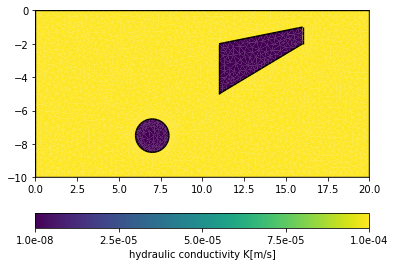

In [10]:
#hydraulic potentials h:
h1 = 5 #m
h2 = 0.2 #m
bc = {"Dirichlet": {1: h1, 3: h2}}
#hydraulic conductivity K:
K = pg.solver.parseMapToCellArray([[1,1e-4],[2,1e-7],[3,1e-8]], mesh1)
K = np.array(K)
pg.show(mesh1, K , label="hydraulic conductivity K[m/s]")

In [11]:
#from Darcy import solveDarcy
#h = solveDarcy(mesh1, K ,bc)
h = pg.solver.solveFiniteElements(mesh1, K ,bc=bc)

In [13]:
from pygimli.viewer.pv import drawStreamLines, drawSlice

(<AxesSubplot:>, None)

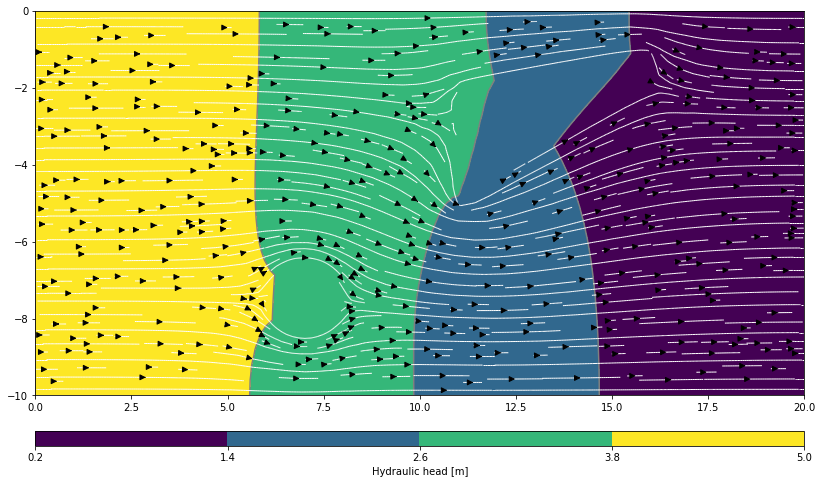

In [16]:
por = 0.3
grad_h = pg.solver.grad(mesh1, h)
v = ((-K*grad_h.T).T)/por #m/s
v_x = v[:,0] #m/s
v_y = v[:,1] #m/s
v_z = v[:,2] #m/s
v_abs = abs(np.sqrt((v_x**2+v_y**2))) #m/s
fig, axes = plt.subplots(figsize =(16,8))
ax, _ = pg.show(mesh1, h, ax=axes, label= "Hydraulic head [m]", hold=True)
pg.show(mesh1, v, ax=ax, color = 'w', dropTol=1e-6)

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


(<AxesSubplot:>, None)

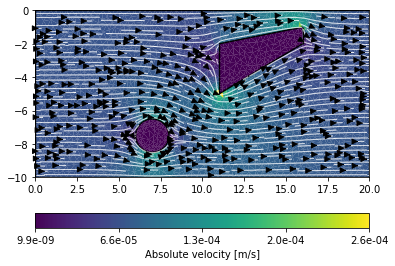

In [17]:
ax, _ = pg.show(mesh1, v_abs, hold=True, label="Absolute velocity [m/s]")
pg.show(mesh1, v, ax=ax, color="w", dropTol=1e-6)

# 2. streaming potential

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x1eab9877448>)

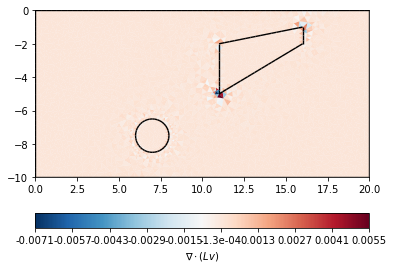

In [30]:
L = 10
rhs = pg.solver.div(mesh1, L*v)
#ax, _ = pg.show(mesh1, v, hold=True)
pg.show(mesh1, rhs, label = r"$\nabla \cdot (Lv)$", hold = True, nLevs = 10, cMap = "RdBu_r")

(<AxesSubplot:xlabel='$\\nabla \\cdot (\\nabla h)$'>,
 <matplotlib.colorbar.Colorbar at 0x1eab951a8c8>)

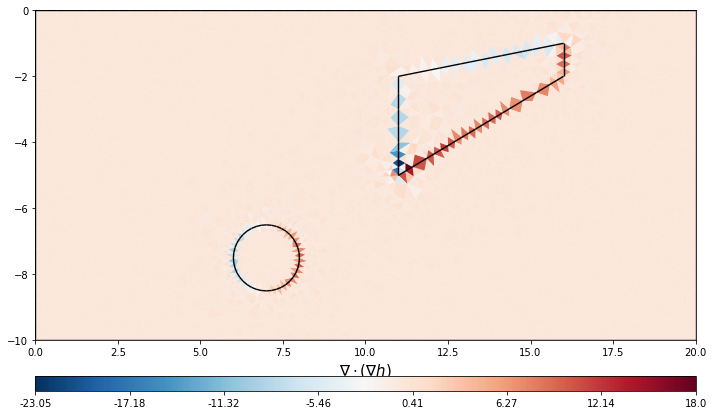

In [29]:
div_grad_h = pg.solver.div(mesh1, grad_h/por)
fig, ax = plt.subplots(figsize =(14,7))
ax.set_xlabel(r"$\nabla \cdot (\nabla h)$", fontsize="15")
pg.show(mesh1, div_grad_h, ax=ax, hold = True, nLevs = 8, cMap = "RdBu_r")

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x1eab89f6848>)

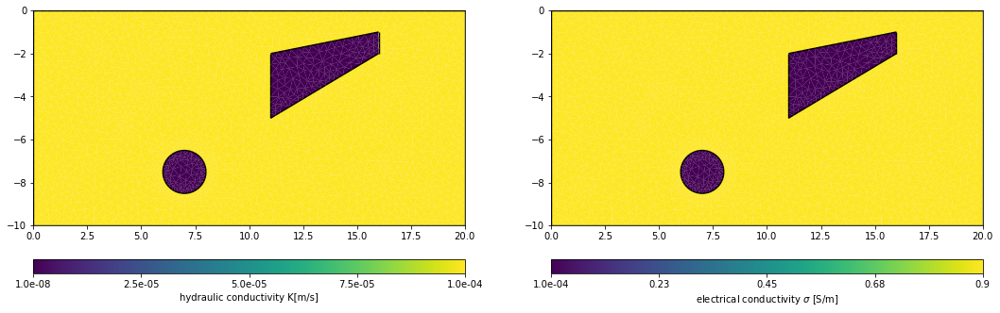

In [23]:
#streaming potentials:
phi1 = 0 #V
phi2 = 0 #V
bc_lhs = {"Dirichlet": {1: phi1, 3: phi2}}

#electrical conductivity sigma:
sigma = pg.solver.parseMapToCellArray([[1,9e-1],[2,3e-4],[3,1e-4]], mesh1)
sigma = np.array(sigma)
fig,ax = plt.subplots(1,2,figsize=(18, 9))
pg.show(mesh1, K , ax=ax[0],hold=True, label="hydraulic conductivity K[m/s]")
pg.show(mesh1, sigma, ax=ax[1], hold=True, label=r"electrical conductivity " r"$\sigma$ [S/m]")

In [57]:
from pygimli.solver import solve
#from StreamPotential import solveStreampot
#phi,E = pg.solver.solveFiniteElements(mesh1, sigma, bc=bc_lhs, rhs)
#phi = pg.solver.solveFiniteElements(mesh1, sigma, rhs, bc=bc_lhs)
k=1e-3
phi = solve(mesh1, a=sigma, b=0, f=rhs,
          bc=bc_lhs)

Text(0.5, 0, 'x')

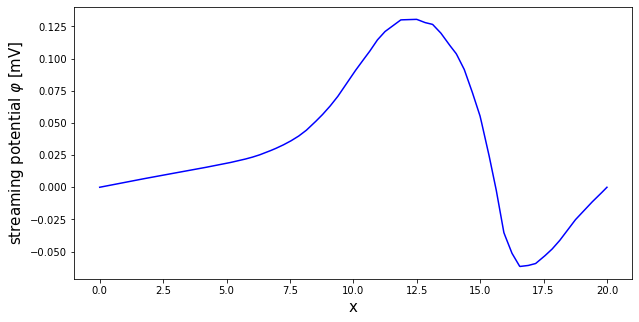

In [58]:
depth = 0
phi = np.array(phi)
x = np.linspace(mesh1.xmin(),mesh1.xmax(),1000)
x2 = [[i,mesh1.ymax()- depth] for i in x]
phi_x = pg.interpolate(mesh1,phi,x2)
fig, ax = plt.subplots(figsize =(10,5))
ax.plot(x, phi_x*1000,"b")
ax.set_ylabel(r"streaming potential " r"$\varphi$ [mV]",fontsize="15")
ax.set_xlabel('x',fontsize="15")

# 3. mesh extension

(<AxesSubplot:>, <matplotlib.colorbar.Colorbar at 0x1eab2588f88>)

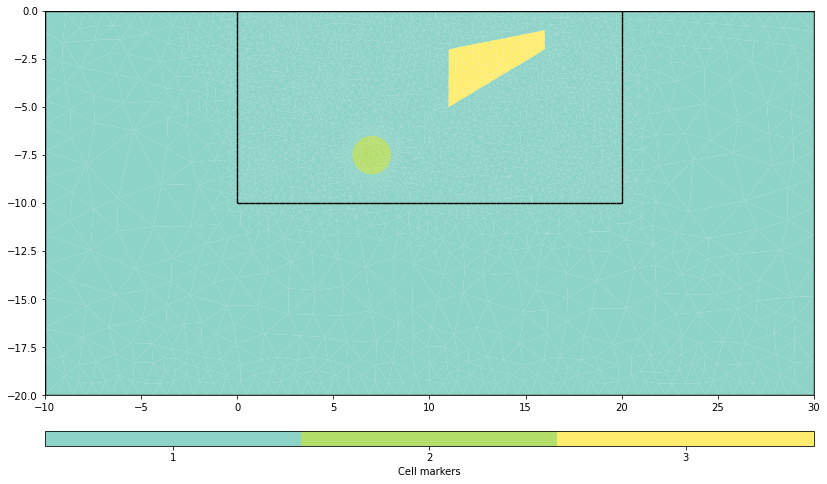

In [46]:
fig, ax = plt.subplots(figsize =(16,8))
mesh_big = mt.appendTriangleBoundary(mesh1, xbound=10, ybound=10)
pg.show(mesh_big, ax=ax, markers=True)

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


(<AxesSubplot:title={'center':'streaming potential $\\varphi$ [mV] interpolated on big mesh'}>,
 <matplotlib.colorbar.Colorbar at 0x1eabec66c48>)

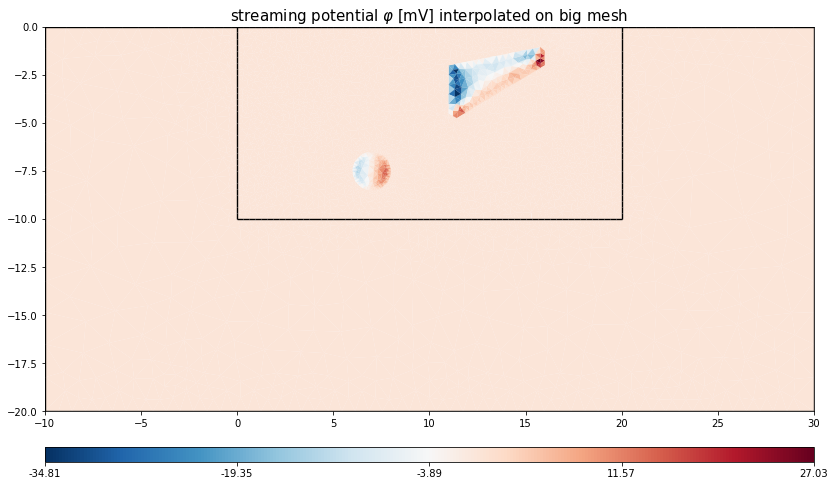

In [59]:
phi_mesh_big = pg.interpolate(mesh1, phi*1000, mesh_big.cellCenters())
fig, ax = plt.subplots(figsize =(16,8))
ax.set_title(r"streaming potential " r"$\varphi$ [mV] interpolated on big mesh", fontsize="15")
pg.show(mesh_big, phi_mesh_big, ax=ax, hold = True, cMap = 'RdBu_r',label="")

# 4. tracer transport

In [60]:
S1 = np.zeros(mesh1.cellCount())
S2 = np.zeros(mesh1.cellCount())
S3 = np.zeros(mesh1.cellCount())
print(mesh1.cellCount())
inj_pos1 = [5,-7.5]
inj_pos2 = [2.5,-3]
inj_pos3 = [8,-3.5]
cell1 = mesh1.findCell(inj_pos1)
cell2 = mesh1.findCell(inj_pos2)
cell3 = mesh1.findCell(inj_pos3)
start1 = cell1.id()
start2 = cell2.id()
start3 = cell3.id()
print(cell1.size())
print(cell2.size())
print(cell3.size())
S1[start1] = 1*0.001/cell1.size() # in [mg/(l*s)]
S2[start2] = 5*0.001/cell2.size() # in [mg/(l*s)]
S3[start3] = 100*0.001/cell3.size() # in [mg/(l*s)]
# print(cell1)
# print(S[start1])
# pg.show(mesh1, S, label='')

3978
0.06252700576599153
0.05144990225157989
0.07674618571752757


In [61]:
alpha = 1e-3
D = alpha*v_abs #m/s
print(D)

[8.65839951e-08 8.46975323e-08 1.56216913e-10 ... 7.05891775e-08
 7.06880694e-08 7.04936806e-08]


In [62]:
steps = 100
timeperiod = 5*24*3600 #in sec
del_t = timeperiod/(steps-1) #in sec
del_t_h = del_t/3600 #in hours
#np.savetxt("del_t", [del_t])
times = np.linspace(0,timeperiod,steps)
ht1 = times[:int(steps*1/4)]
ht2 = times[ht1.size:int(steps*28/100)]
ht3 = times[ht2.size:int(steps*1/2)]
ht4 = times[ht3.size:len(times)]

In [63]:
#CFL:
dx = 0.15183198890032965
c = v.max()*del_t/dx
print(v.max(),c)

0.00025771981971927006 7.406842162194538


In [64]:
# from Transport import solveTransport
# c = solveTransport(mesh1, D, v, S, ht)
from pygimli.solver import solveFiniteVolume as solveFV
c1 = solveFV(mesh1, a = D, scheme="PS", vel = v, f = S2, times = ht1)
c2 = solveFV(mesh1, a = D, scheme="PS", vel = v, f = S3, times = ht2, u0 = c1[-1])
c3 = solveFV(mesh1, a = D, scheme="PS", vel = v, f = S1, times = ht3, u0 = c2[-1])
c4 = solveFV(mesh1, a = D, scheme="PS", vel = v, f = 0, times = ht4, u0 = c3[-1])
c = np.vstack([c1,c2,c3,c4])

01/10/20 - 23:11:41 - pyGIMLi - WARNING - Courant-Friedrichs-Lewy Number: 4.735974245944364 but should be lower 1 to ensure movement inside a cell per timestep. (vMax = 0.00016478742251181642 dt = 4363.636363636364 dx = 0.15183198890032965 dt < 921.3809317846586  | N >  114 )
01/10/20 - 23:11:42 - pyGIMLi - WARNING - Courant-Friedrichs-Lewy Number: 4.735974245944368 but should be lower 1 to ensure movement inside a cell per timestep. (vMax = 0.00016478742251181642 dt = 4363.636363636368 dx = 0.15183198890032965 dt < 921.3809317846586  | N >  10 )
01/10/20 - 23:11:43 - pyGIMLi - WARNING - Courant-Friedrichs-Lewy Number: 4.735974245944364 but should be lower 1 to ensure movement inside a cell per timestep. (vMax = 0.00016478742251181642 dt = 4363.636363636364 dx = 0.15183198890032965 dt < 921.3809317846586  | N >  218 )
01/10/20 - 23:11:44 - pyGIMLi - WARNING - Courant-Friedrichs-Lewy Number: 4.735974245944353 but should be lower 1 to ensure movement inside a cell per timestep. (vMax = 0

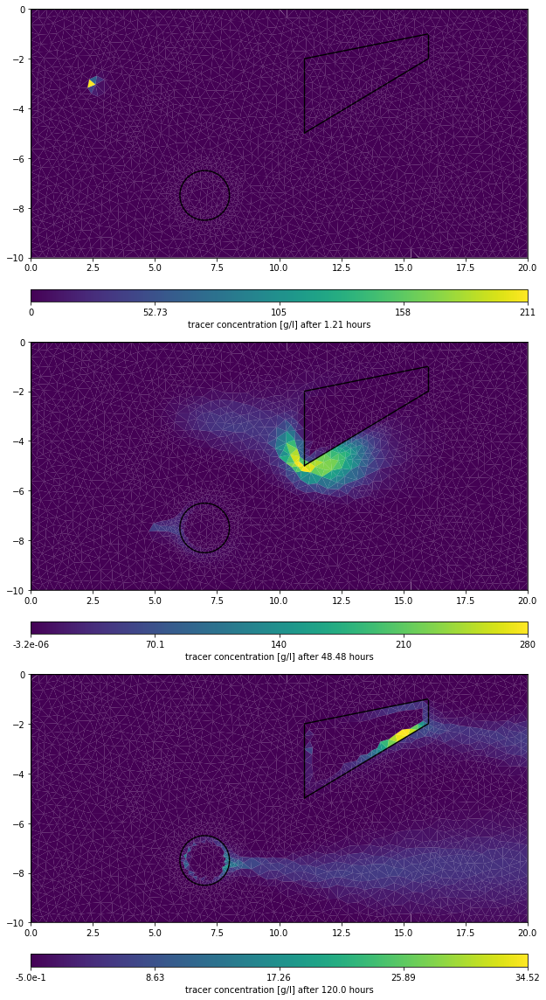

In [65]:
frames = [round(steps*0.01),round(steps*0.4),round(steps*0.99)]
fig, axes = plt.subplots(3,1,figsize =(32,16))
# pg.show(mesh1, c1[frames[0]]*0.001, ax=axes[0], hold=True,cMax=25)
# pg.show(mesh1, c1[frames[1]]*0.001, ax=axes[1], hold=True,cMax=25)
# pg.show(mesh1, c1[frames[2]]*0.001, ax=axes[2], hold=True,cMax=25)
pg.show(mesh1, c[frames[0]], label = "tracer concentration [g/l] after {} hours".format(round(frames[0]*del_t_h,2)), ax=axes[0], hold=True)
pg.show(mesh1, c[frames[1]], label = "tracer concentration [g/l] after {} hours".format(round(frames[1]*del_t_h,2)), ax=axes[1], hold=True)
pg.show(mesh1, c[frames[2]], label = "tracer concentration [g/l] after {} hours".format(round(frames[2]*del_t_h,2)), ax=axes[2], hold=True)
fig.tight_layout()

In [66]:
from IPython.display import HTML, clear_output
import matplotlib.animation as animation

In [89]:
%%capture
# Create animation
fig, ax = plt.subplots()

plot_cfg = {
    "cMin": 1,
    "cMax": 300,
    "logScale": False
}

gci = pg.mplviewer.drawModel(ax, mesh1, c[0], **plot_cfg)
pg.mplviewer.createColorBar(gci, label="concentration [$g/l$]", pad=0.55)

def animate(i):
    pg.mplviewer.setMappableData(gci, c[i], **plot_cfg)

# interval is time between frames in ms
anim = animation.FuncAnimation(fig, animate, frames=len(c),
                               interval=50, repeat=False)

In [90]:
HTML(anim.to_jshtml())

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


In [91]:
anim.save('summary_conc_anim.mp4')

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


# 5. el. conductivity and resistivity

In [68]:
# Your answer here
sigma_0=0.1 # mS/cm
sigma_0=0.1*sigma_0 #S/m
sigma_W = 0.1*c+sigma_0

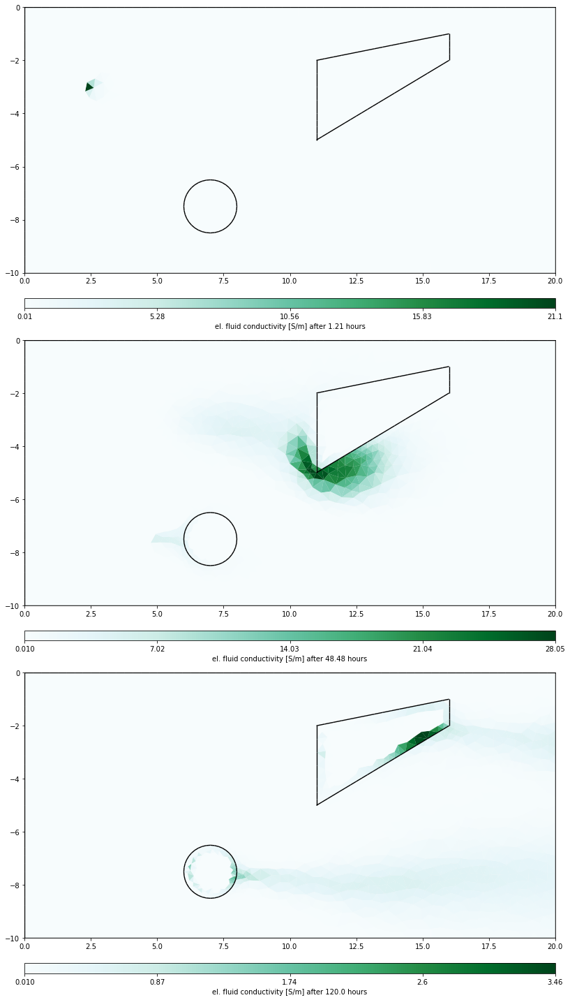

In [70]:
fig,axes = plt.subplots(3,1,figsize =(40,20))
# fluid conductivity:
pg.show(mesh1, sigma_W[frames[0]], label = "el. fluid conductivity [S/m] after {} hours".format(round(frames[0]*del_t_h,2)), cMap="BuGn", ax=axes[0], hold=True)
pg.show(mesh1, sigma_W[frames[1]], label = "el. fluid conductivity [S/m] after {} hours".format(round(frames[1]*del_t_h,2)), cMap="BuGn", ax=axes[1], hold=True)
pg.show(mesh1, sigma_W[frames[2]], label = "el. fluid conductivity [S/m] after {} hours".format(round(frames[2]*del_t_h,2)), cMap="BuGn", ax=axes[2], hold=True)
fig.tight_layout()

# Excercise 3: Transform fluid conductivity into bulk resistivity of the rock
Write a function for Archie's Law and choose reasonable parameters for $a$ and $m$ depending on your underground model.

*Hint: Have a look at equation 11 in the [pyGIMLi paper](http://www.sciencedirect.com/science/article/pii/S0098300417300584/pdfft?md5=44253eaacd5490e3fb32210671672496&pid=1-s2.0-S0098300417300584-main.pdf).*

- Are the values realistic?
- What is the resistivity contrast between water- and salt-water saturated rock?

In [71]:
# Your answer here
# Archie's equation:
a=1
m=2
n=2
S=1
rho_b = a*(1/sigma_W)*(por**(-m))*(S**(-n))

In [72]:
from IPython.display import HTML, clear_output
import matplotlib.animation as animation

In [84]:
%%capture
# Create animation
fig, ax = plt.subplots()

plot_cfg = {
    "cMin": 1,
    "cMax": 1000,
    "logScale": False
}

gci = pg.mplviewer.drawModel(ax, mesh1, rho_b[0], cMap="PuBu", **plot_cfg)
pg.mplviewer.createColorBar(gci, label="resistivity [$\Omega m$]", pad=0.55)

def animate(i):
    pg.mplviewer.setMappableData(gci, rho_b[i], **plot_cfg)

# interval is time between frames in ms
anim = animation.FuncAnimation(fig, animate, frames=len(rho_b),
                               interval=30, repeat=False)

01/10/20 - 23:35:12 - pyGIMLi - WARNING - cMap|cmap argument is deprecated for draw functions. Please use show or customize a colorbar.


In [85]:
HTML(anim.to_jshtml())

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


In [86]:
#anim.save('summary_roh_anim.mp4')

C:\Users\michi\Anaconda3\envs\pg\lib\site-packages\pygimli\viewer\mpl\colorbar.py:434: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  mappable.get_cmap().set_bad([1.0, 1.0, 1.0, 0.0])


In [78]:
elecs = np.linspace(5,15,15) # x coordinate of the electrodes

# Create a Dipole Dipole ('dd') measuring scheme 
scheme = pb.createData(elecs=elecs, schemeName='dd')

# Put all electrodes (aka. sensors positions) into the geometry to enforce mesh
# refinement. Due to experience known, its convenient to add further refinement
# nodes in a distance of 10% of electrode spacing, to achieve sufficient
# numerical accuracy.
for pos in scheme.sensorPositions():
    geometry.createNode(pos)
    geometry.createNode(pos+pg.RVector3(0, -0.1))

# Create a mesh for the finite element modelling with appropriate mesh quality.
mesh1 = mt.createMesh(geometry, quality=34)

# Optional: take a look at the mesh
pg.show(mesh1)

NameError: name 'pb' is not defined

relativeError set to a value > 0.5 .. assuming this is a percentage Error level dividing them by 100
Data error estimate (min:max)  0.020121504022161587 : 0.047871437054031185


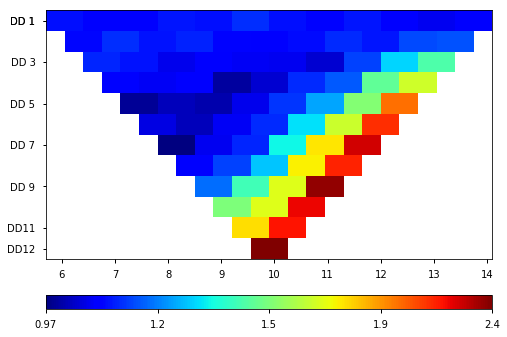

In [194]:
# Create a map to set resistivity values in the appropriate regions
# [[regionNumber, resistivity], [regionNumber, resistivity], [...]
rhomap = [[1, 1/9e-1],
          [2, 1/3e-4],[3, 1/1e-4]]

# Initialize the ERTManager
ert = pb.Resistivity()

# Perform the modeling with the mesh and the measuring scheme itself
# and return a data container with apparent resistivity values,
# geometric factors and estimated data errors specified by the noise setting.
# The noise is also added to the data.
data = ert.simulate(mesh1, res=rhomap, scheme=scheme,
                    noiseLevel=2, noiseAbs=1e-5)

# Optional: take a look at the data (electrical pseudo section)
pb.show(data)

In [ ]:
# Run the ERTManager to invert the modelled data.
# The necessary inversion mesh is generated automatically.
model = ert.invert(data, maxCellArea=0.2, lam=30)

# Let the ERTManger show you the model and fitting results of the last
# successful run.
ert.showModel()